In [3]:
from src.api import API

In [4]:
# api = API()
# api.main()

In [27]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import ast
import re

In [22]:
df = pd.read_csv('./data/raw/data.csv')
df.head()

,modelId,lastModified,tags,pipeline_tag,author,architectures,model_type,datasets,downloads,library_name
0,jonatasgrosman/wav2vec2-large-xlsr-53-english,2023-03-25T10:56:55.000Z,"['pytorch', 'jax', 'safetensors', 'wav2vec2', ...",automatic-speech-recognition,jonatasgrosman,['Wav2Vec2ForCTC'],wav2vec2,"['common_voice', 'mozilla-foundation/common_vo...",47102358,transformers
1,bert-base-uncased,2022-11-16T15:15:39.000Z,"['pytorch', 'tf', 'jax', 'rust', 'safetensors'...",fill-mask,NaN,['BertForMaskedLM'],bert,"['bookcorpus', 'wikipedia']",46484719,transformers
2,Davlan/distilbert-base-multilingual-cased-ner-hrl,2022-06-27T10:49:50.000Z,"['pytorch', 'tf', 'distilbert', 'token-classif...",token-classification,Davlan,['DistilBertForTokenClassification'],distilbert,NaN,29407063,transformers
3,gpt2,2022-12-16T15:44:21.000Z,"['pytorch', 'tf', 'jax', 'tflite', 'rust', 'sa...",text-generation,NaN,['GPT2LMHeadModel'],gpt2,NaN,21999611,transformers
4,xlm-roberta-base,2023-04-07T12:46:17.000Z,"['pytorch', 'tf', 'jax', 'onnx', 'safetensors'...",fill-mask,NaN,['XLMRobertaForMaskedLM'],xlm-roberta,NaN,20333162,transformers


In [2]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 176380 entries, 0 to 176379
Data columns (total 10 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   modelId        176380 non-null  object
 1   lastModified   176380 non-null  object
 2   tags           176380 non-null  object
 3   pipeline_tag   105339 non-null  object
 4   author         176312 non-null  object
 5   architectures  83455 non-null   object
 6   model_type     84561 non-null   object
 7   datasets       24153 non-null   object
 8   downloads      176380 non-null  int64 
 9   library_name   107656 non-null  object
dtypes: int64(1), object(9)
memory usage: 13.5+ MB


In [3]:
sum(df['tags'] =='[]')

45533

In [23]:
sum(df['architectures'] =='[]')

1

In [20]:
#Observed that null values appear as []
df['tags'].replace('[]', np.nan, inplace=True)
df['architectures'].replace('[]', np.nan, inplace=True)

In [7]:
df.isna().sum()

modelId               0
lastModified          0
tags              45533
pipeline_tag      71041
author               68
architectures     92926
model_type        91819
datasets         152227
downloads             0
library_name      68724
dtype: int64

In [24]:
#Looking at unique value counts and items
for col in df.columns:
    print('{} has {} Unique values: \n {}'.format(col, df[col].nunique(), df[col].unique()))

modelId has 176380 Unique values: 
 ['jonatasgrosman/wav2vec2-large-xlsr-53-english' 'bert-base-uncased'
 'Davlan/distilbert-base-multilingual-cased-ner-hrl' ...
 'mekjr1/byt5-base-es_kbh' 'dingzhaohan/identify-my-cat'
 'timm/cait_m36_384.fb_dist_in1k']
lastModified has 175207 Unique values: 
 ['2023-03-25T10:56:55.000Z' '2022-11-16T15:15:39.000Z'
 '2022-06-27T10:49:50.000Z' ... '2023-04-13T01:35:35.000Z'
 '2023-04-13T01:35:47.000Z' '2023-04-13T01:37:00.000Z']
tags has 23100 Unique values: 
 ["['pytorch', 'jax', 'safetensors', 'wav2vec2', 'automatic-speech-recognition', 'en', 'dataset:common_voice', 'dataset:mozilla-foundation/common_voice_6_0', 'transformers', 'audio', 'hf-asr-leaderboard', 'mozilla-foundation/common_voice_6_0', 'robust-speech-event', 'speech', 'xlsr-fine-tuning-week', 'license:apache-2.0', 'model-index', 'has_space']"
 "['pytorch', 'tf', 'jax', 'rust', 'safetensors', 'bert', 'fill-mask', 'en', 'dataset:bookcorpus', 'dataset:wikipedia', 'arxiv:1810.04805', 'transforme

In [18]:
df['architectures'] = df['architectures'].apply(ast.literal_eval)
df['architectures'] = df['architectures'].apply(lambda x: x[0])

In [20]:
df['architectures'][0]

'Wav2Vec2ForCTC'

In [21]:
df['pipeline_tag'].value_counts()

text-classification               90566
reinforcement-learning            17687
text2text-generation              11643
text-generation                   10015
token-classification               8135
automatic-speech-recognition       7566
fill-mask                          6420
question-answering                 4307
feature-extraction                 3630
text-to-image                      3295
image-classification               3014
conversational                     2019
translation                        2006
sentence-similarity                1726
summarization                       956
unconditional-image-generation      603
audio-classification                359
object-detection                    348
text-to-speech                      268
multiple-choice                     260
image-segmentation                  195
audio-to-audio                      146
image-to-text                       135
tabular-classification              126
zero-shot-classification            113


In [22]:
df['library_name'].value_counts()

transformers             152634
stable-baselines3          6669
diffusers                  5172
ml-agents                  2752
sentence-transformers      1968
                          ...  
fastMONAI                     1
bart-base-jax                 1
fastpitch                     1
pytorch-lightning             1
FastAI                        1
Name: library_name, Length: 81, dtype: int64

# Univariate Plots

In [28]:
tagset = set()
for tags in df['tags']:
    pattern = r"\[(.*?)\]"
    matches = re.findall(pattern, tags)
    for match in matches:
        split_match = match.split(',')
        for element in split_match:
            tagset.add(element.strip())
            print(element.strip())

len(tagset)

'pytorch'
'jax'
'safetensors'
'wav2vec2'
'automatic-speech-recognition'
'en'
'dataset:common_voice'
'dataset:mozilla-foundation/common_voice_6_0'
'transformers'
'audio'
'hf-asr-leaderboard'
'mozilla-foundation/common_voice_6_0'
'robust-speech-event'
'speech'
'xlsr-fine-tuning-week'
'license:apache-2.0'
'model-index'
'has_space'
'pytorch'
'tf'
'jax'
'rust'
'safetensors'
'bert'
'fill-mask'
'en'
'dataset:bookcorpus'
'dataset:wikipedia'
'arxiv:1810.04805'
'transformers'
'exbert'
'license:apache-2.0'
'autotrain_compatible'
'has_space'
'pytorch'
'tf'
'distilbert'
'token-classification'
'transformers'
'autotrain_compatible'
'has_space'
'pytorch'
'tf'
'jax'
'tflite'
'rust'
'safetensors'
'gpt2'
'text-generation'
'en'
'doi:10.57967/hf/0039'
'transformers'
'exbert'
'license:mit'
'has_space'
'pytorch'
'tf'
'jax'
'onnx'
'safetensors'
'xlm-roberta'
'fill-mask'
'multilingual'
'af'
'am'
'ar'
'as'
'az'
'be'
'bg'
'bn'
'br'
'bs'
'ca'
'cs'
'cy'
'da'
'de'
'el'
'en'
'eo'
'es'
'et'
'eu'
'fa'
'fi'
'fr'
'fy'
'

12232

In [29]:
tagset = {element.strip('"\'') for element in tagset}
tagset = {element.strip() for element in tagset if not (element.startswith("dataset:") or element.startswith("arxiv:") or element.startswith("doi:") or element.startswith("license:"))}

In [30]:
# split the 'tags' column into a list of tags and create a new column
df['tag_list'] = df['tags'].str.split(',')

# explode the 'tag_list' column to create a new row for each tag
df_exploded = df.explode('tag_list')

# count the frequency of tags that exist in the tagset
tag_counts = df_exploded['tag_list'].apply(lambda x: x.strip("[]' ")).value_counts().nlargest(50)
tag_counts = tag_counts[tag_counts.index.isin(tagset)]

print(tag_counts)

tag_list
transformers                     85463
pytorch                          82434
                                 45535
autotrain_compatible             34202
tensorboard                      31358
model-index                      24898
generated_from_trainer           21711
bert                             19900
text-classification              19833
reinforcement-learning           17790
text2text-generation             14473
en                               14464
deep-reinforcement-learning      12194
text-generation                  11968
gpt2                             10315
token-classification              8166
jax                               8137
automatic-speech-recognition      7585
custom-implementation             7413
roberta                           7187
distilbert                        7142
tf                                6826
stable-baselines3                 6686
has_space                         6652
fill-mask                         6471
t5              

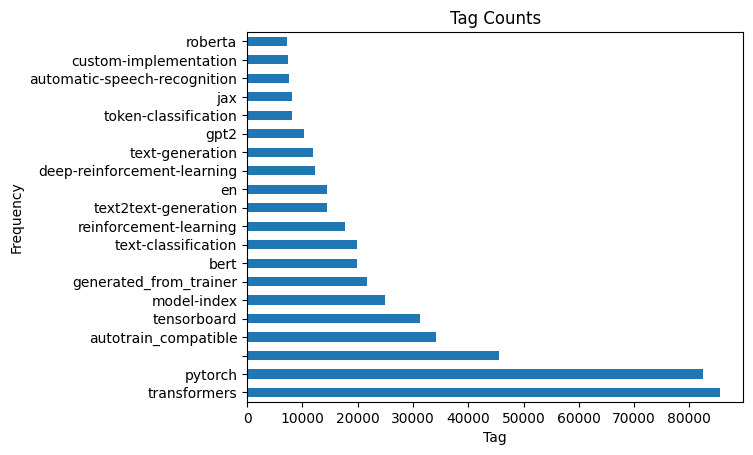

In [33]:
tag_counts.nlargest(20).plot(kind='barh')
plt.title('Tag Counts')
plt.xlabel('Tag')
plt.ylabel('Frequency')
plt.show()

In [24]:
top10_pt = df['pipeline_tag'].value_counts().iloc[:10].index
df.loc[~df['pipeline_tag'].isin(top10_pt),'Location']='Other'

<AxesSubplot: xlabel='count', ylabel='pipeline_tag'>

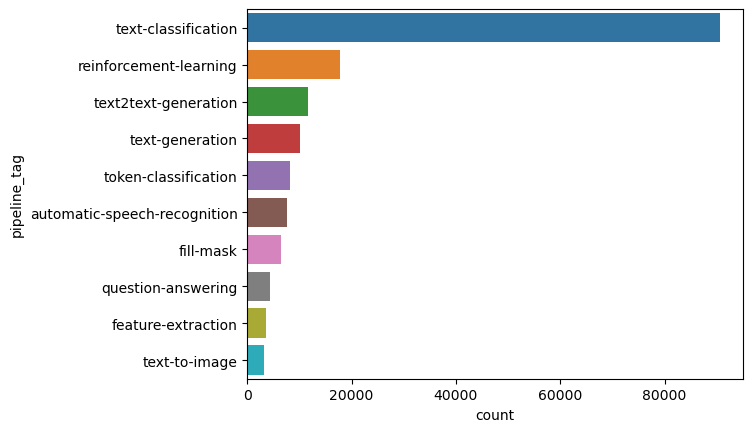

In [26]:
sns.countplot(y = 'pipeline_tag', data = df, order = top10_pt)

<AxesSubplot: xlabel='count', ylabel='library_name'>

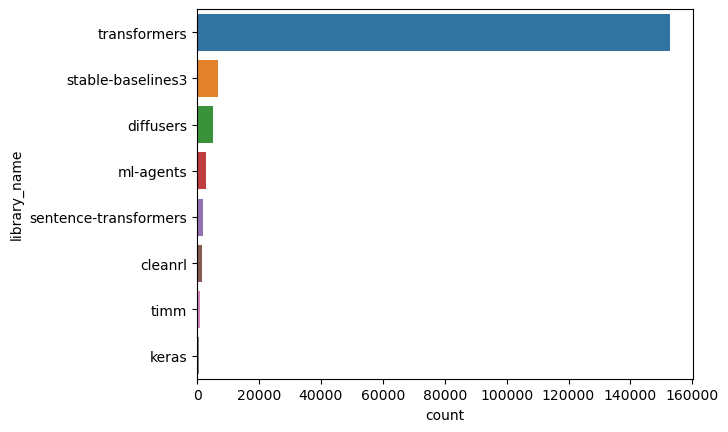

In [27]:
top8_ln = df['library_name'].value_counts().iloc[:8].index
df.loc[~df['library_name'].isin(top8_ln),'Location']='Other'
sns.countplot(y = 'library_name', data = df, order = top8_ln)

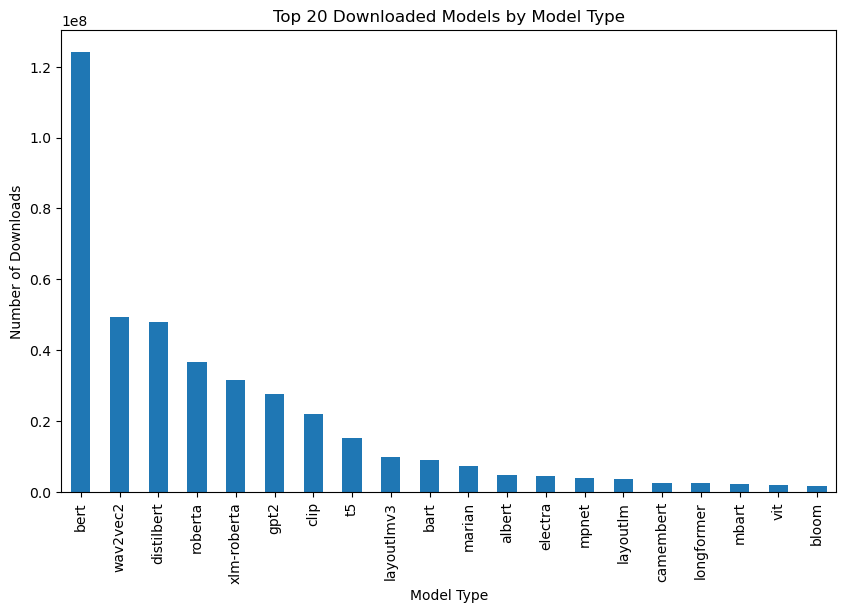

In [28]:
import matplotlib.pyplot as plt
top20_dl_data = df.groupby('model_type')['downloads'].sum().sort_values(ascending=False).iloc[:20]
top20_dl = df.groupby('model_type')['downloads'].sum().sort_values(ascending=False).iloc[:20].index
top20_dl_data.plot.bar(figsize=(10, 6))
plt.title("Top 20 Downloaded Models by Model Type")
plt.xlabel("Model Type")
plt.ylabel("Number of Downloads")
plt.show()

# Multivariate Plots

In [29]:
df.groupby('model_type').sum()

/tmp/ipykernel_101647/2051843505.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df.groupby('model_type').sum()


,downloads
model_type,
A2N,788
AWSRN,745
BERT_CRF,133
BERT_Cat,48
BPE,0
...,...
xmod,5530
yolos,380007
yolov5,1


In [43]:
dl_data_mt = df.groupby(['model_type', 'pipeline_tag']).sum().reset_index(drop=False).sort_values('downloads', ascending=False).iloc[:20]
dl_data_mt

/tmp/ipykernel_101647/2603167096.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  dl_data_mt = df.groupby(['model_type', 'pipeline_tag']).sum().reset_index(drop=False).sort_values('downloads', ascending=False).iloc[:20]


,model_type,pipeline_tag,downloads
84,bert,fill-mask,70647815
981,wav2vec2,automatic-speech-recognition,48709904
317,distilbert,token-classification,29956301
1016,xlm-roberta,fill-mask,27354079
435,gpt2,text-generation,26584833
793,roberta,fill-mask,20846128
201,clip,zero-shot-image-classification,19231083
101,bert,text-classification,16826958
310,distilbert,fill-mask,10628727
103,bert,text-to-image,10466909


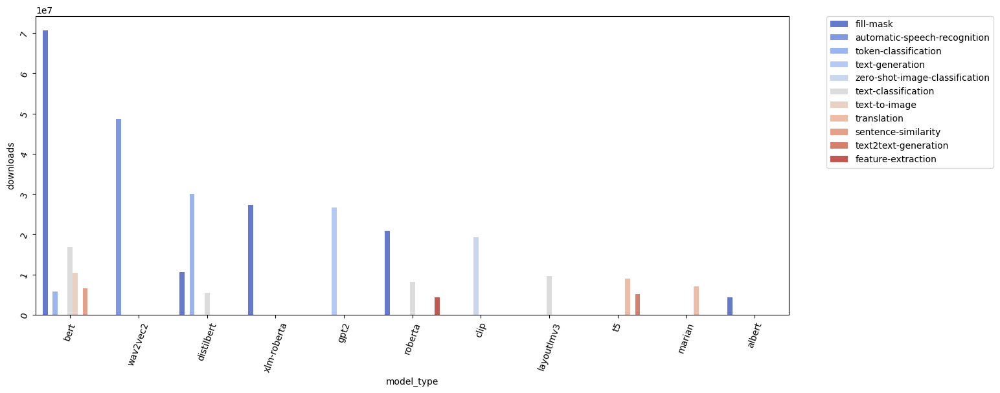

In [46]:
plt.figure(figsize=(15,6))
ax = sns.barplot(x='model_type', y='downloads',hue='pipeline_tag', data=dl_data_mt,
                 palette="coolwarm")
plt.xticks(rotation=70)
ax.tick_params( rotation=70)
# Change legend position
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0)

In [ ]:
dl_data_ac = df.groupby(['architectures', 'pipeline_tag']).sum().reset_index(drop=False).sort_values('downloads', ascending=False).iloc[:20]
dl_data_ac

In [49]:
dl_data_ln = df.groupby(['library_name', 'pipeline_tag']).sum().reset_index(drop=False).sort_values('downloads', ascending=False).iloc[:20]
dl_data_ln

/tmp/ipykernel_101647/3876982164.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  dl_data_ln = df.groupby(['library_name', 'pipeline_tag']).sum().reset_index(drop=False).sort_values('downloads', ascending=False).iloc[:20]


,library_name,pipeline_tag,downloads
235,transformers,fill-mask,136429327
252,transformers,text-classification,57241796
230,transformers,automatic-speech-recognition,49331127
258,transformers,token-classification,36577631
253,transformers,text-generation,34020618
234,transformers,feature-extraction,21101728
265,transformers,zero-shot-image-classification,19245368
259,transformers,translation,16452565
190,sentence-transformers,sentence-similarity,11360192
54,diffusers,text-to-image,10466000


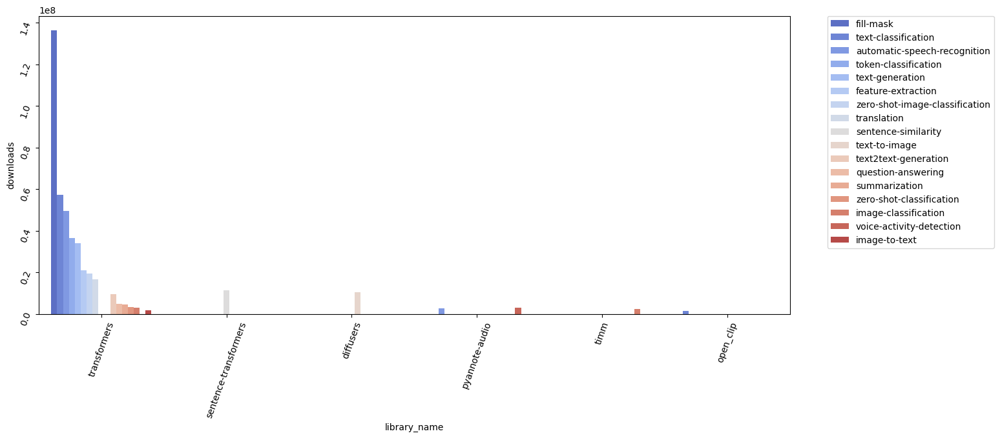

In [50]:
plt.figure(figsize=(15,6))
ax = sns.barplot(x='library_name', y='downloads',hue='pipeline_tag', data=dl_data_ln,
                 palette="coolwarm")
plt.xticks(rotation=70)
ax.tick_params( rotation=70)
# Change legend position
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0)

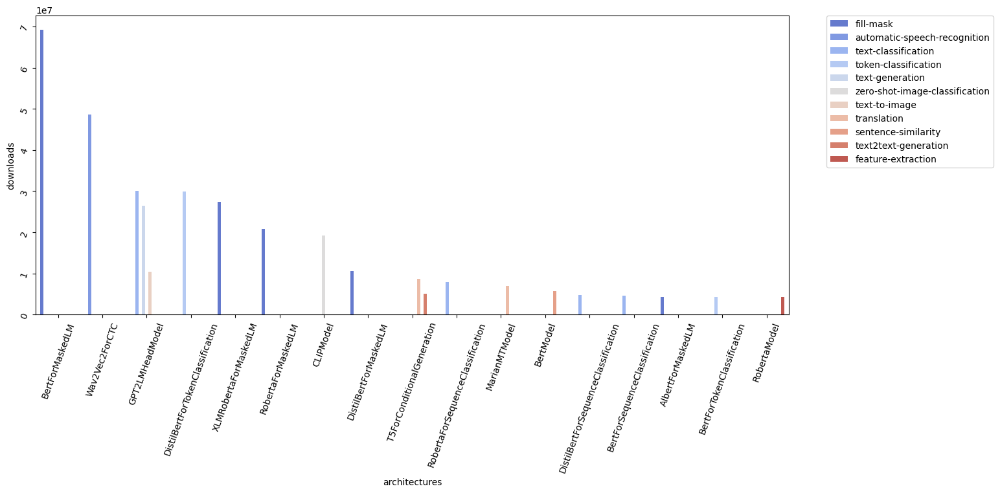

In [48]:
plt.figure(figsize=(15,6))
ax = sns.barplot(x='architectures', y='downloads',hue='pipeline_tag', data=dl_data_ac,
                 palette="coolwarm")
plt.xticks(rotation=70)
ax.tick_params( rotation=70)
# Change legend position
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0)

In [16]:
df2 = df[:10000]

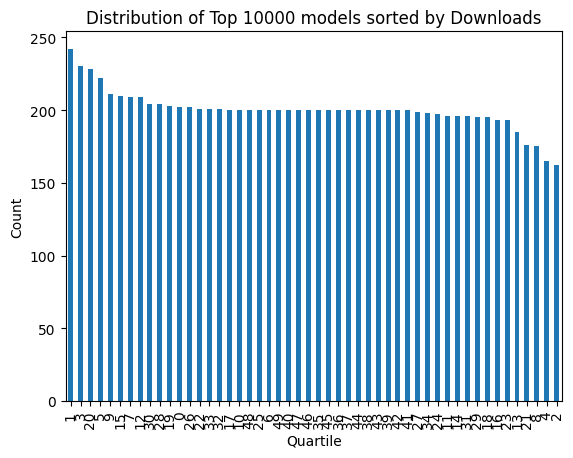

In [25]:
# Divide the data into quartiles
quartiles = pd.qcut(df2['downloads'], q=50, labels=False)

# Count the number of values in each quartile
counts = quartiles.value_counts()

# Plot a bar chart of the quartile counts
counts.plot(kind='bar')

# Add labels and title
plt.xlabel('Quartile')
plt.ylabel('Count')
plt.title('Distribution of Top 10000 models sorted by Downloads')

# Show the plot
plt.show()